# Import necessary libraries and # Load the dataset

In [2]:
# Import necessary libraries
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
# Load the dataset with the correct delimiter
data_path = '../data/raw/data.csv'  # Adjust this path as necessary
df = pd.read_csv(data_path, delimiter=';')  # Specify semicolon as the delimiter

In [3]:
# Display the first few rows
df.head()

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,Graduate


In [4]:
# Check the shape and data types
print(f"Dataset shape: {df.shape}")
print(df.dtypes)

Dataset shape: (4424, 37)
Marital status                                      int64
Application mode                                    int64
Application order                                   int64
Course                                              int64
Daytime/evening attendance\t                        int64
Previous qualification                              int64
Previous qualification (grade)                    float64
Nacionality                                         int64
Mother's qualification                              int64
Father's qualification                              int64
Mother's occupation                                 int64
Father's occupation                                 int64
Admission grade                                   float64
Displaced                                           int64
Educational special needs                           int64
Debtor                                              int64
Tuition fees up to date                       

In [5]:
# Check the shape of the dataset
print(f"Dataset shape: {df.shape}")

Dataset shape: (4424, 37)


In [6]:
# Check the data types of each column
print(df.dtypes)

Marital status                                      int64
Application mode                                    int64
Application order                                   int64
Course                                              int64
Daytime/evening attendance\t                        int64
Previous qualification                              int64
Previous qualification (grade)                    float64
Nacionality                                         int64
Mother's qualification                              int64
Father's qualification                              int64
Mother's occupation                                 int64
Father's occupation                                 int64
Admission grade                                   float64
Displaced                                           int64
Educational special needs                           int64
Debtor                                              int64
Tuition fees up to date                             int64
Gender        

In [7]:
# Get summary statistics
df.describe()

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 1st sem (without evaluations),Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP
count,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,...,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000
mean,1.178571,18.669078,1.727848,8856.642631,0.890823,4.577758,132.613314,1.873192,19.561935,22.275316,...,0.137658,0.541817,6.232143,8.063291,4.435805,10.230206,0.150316,11.566139,1.228029,0.001969
std,0.605747,17.484682,1.313793,2063.566416,0.311897,10.216592,13.188332,6.914514,15.603186,15.343108,...,0.690880,1.918546,2.195951,3.947951,3.014764,5.210808,0.753774,2.663850,1.382711,2.269935
min,1.000000,1.000000,0.000000,33.000000,0.000000,1.000000,95.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.600000,-0.800000,-4.060000
25%,1.000000,1.000000,1.000000,9085.000000,1.000000,1.000000,125.000000,1.000000,2.000000,3.000000,...,0.000000,0.000000,5.000000,6.000000,2.000000,10.750000,0.000000,9.400000,0.300000,-1.700000
50%,1.000000,17.000000,1.000000,9238.000000,1.000000,1.000000,133.100000,1.000000,19.000000,19.000000,...,0.000000,0.000000,6.000000,8.000000,5.000000,12.200000,0.000000,11.100000,1.400000,0.320000
75%,1.000000,39.000000,2.000000,9556.000000,1.000000,1.000000,140.000000,1.000000,37.000000,37.000000,...,0.000000,0.000000,7.000000,10.000000,6.000000,13.333333,0.000000,13.900000,2.600000,1.790000
max,6.000000,57.000000,9.000000,9991.000000,1.000000,43.000000,190.000000,109.000000,44.000000,44.000000,...,12.000000,19.000000,23.000000,33.000000,20.000000,18.571429,12.000000,16.200000,3.700000,3.510000


In [8]:
df.describe(include=['object', 'category'])

,Target
count,4424
unique,3
top,Graduate
freq,2209


# EDA

## 1.Univariate Analysis

### Create histograms and box plots for numerical variables and bar charts for categorical variables, along with descriptive statistics.

In [9]:
# Univariate Analysis for Numerical Variables (Histograms and Box Plots)
numerical_columns = df.select_dtypes(include=['int64', 'float64']).columns

c:\Users\matiwos.desalegn\AppData\Local\miniconda3\envs\student-dropout-prediction\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


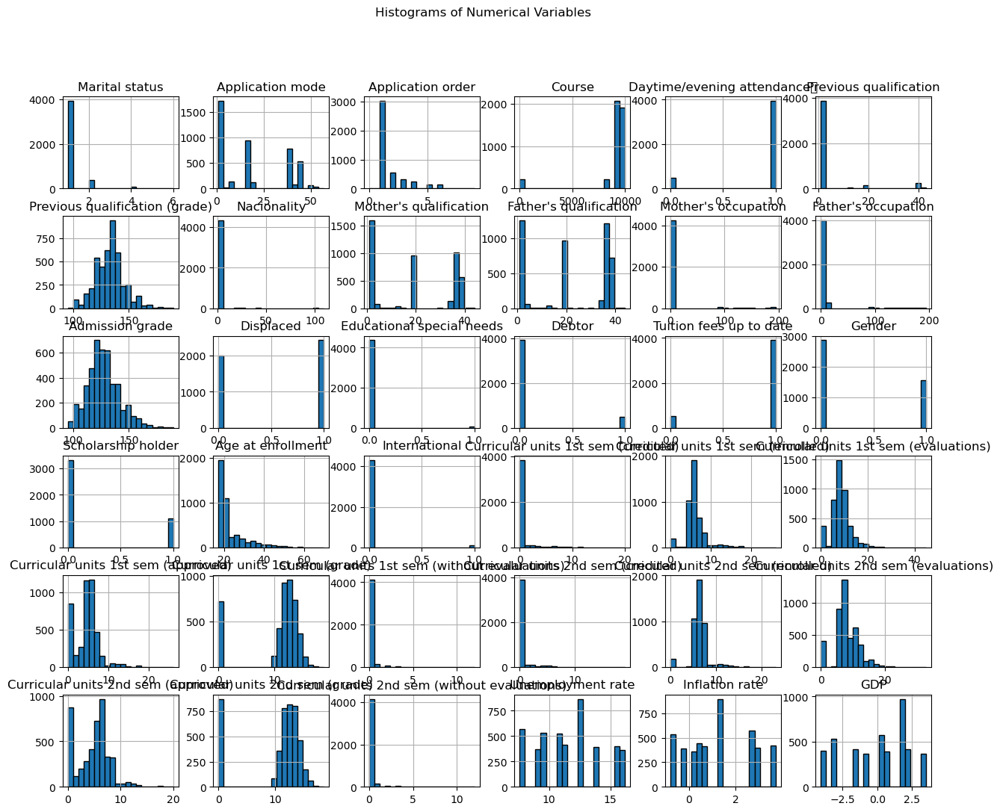

In [10]:
# Histograms for numerical variables
df[numerical_columns].hist(figsize=(15, 12), bins=20, edgecolor='black')
plt.suptitle('Histograms of Numerical Variables')
plt.show()

C:\Users\matiwos.desalegn\AppData\Local\Temp\ipykernel_45416\1009060163.py:7: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  plt.tight_layout()
c:\Users\matiwos.desalegn\AppData\Local\miniconda3\envs\student-dropout-prediction\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


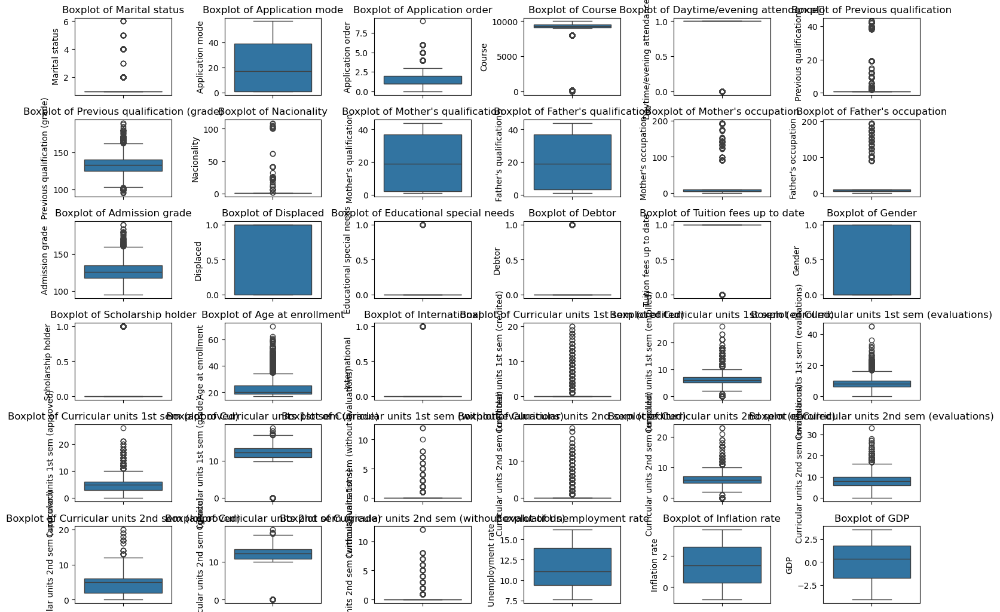

In [11]:
# Box plots for numerical variables
plt.figure(figsize=(15, 12))
for i, col in enumerate(numerical_columns):
    plt.subplot(7, 6, i+1)
    sns.boxplot(y=df[col])
    plt.title(f'Boxplot of {col}')
plt.tight_layout()
plt.show()

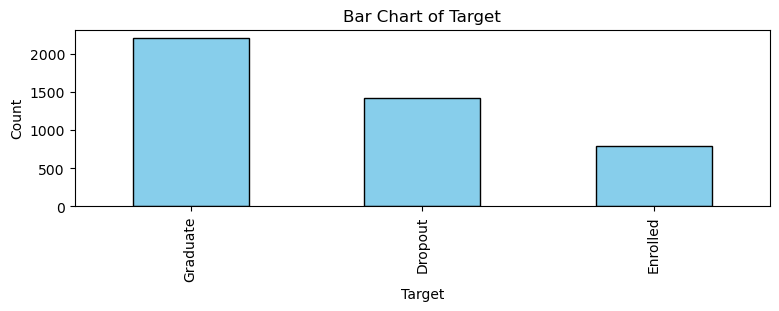

In [13]:
# Bar charts for categorical variables
categorical_columns = df.select_dtypes(include=['object']).columns

plt.figure(figsize=(15, 8))
for i, col in enumerate(categorical_columns):
    plt.subplot(3, 2, i+1)
    df[col].value_counts().plot(kind='bar', color='skyblue', edgecolor='black')
    plt.title(f'Bar Chart of {col}')
    plt.ylabel('Count')
plt.tight_layout()
plt.show()

In [14]:
# Descriptive statistics for numerical variables
print(df[numerical_columns].describe())

       Marital status  Application mode  Application order       Course  \
count     4424.000000       4424.000000        4424.000000  4424.000000   
mean         1.178571         18.669078           1.727848  8856.642631   
std          0.605747         17.484682           1.313793  2063.566416   
min          1.000000          1.000000           0.000000    33.000000   
25%          1.000000          1.000000           1.000000  9085.000000   
50%          1.000000         17.000000           1.000000  9238.000000   
75%          1.000000         39.000000           2.000000  9556.000000   
max          6.000000         57.000000           9.000000  9991.000000   

       Daytime/evening attendance\t  Previous qualification  \
count                   4424.000000             4424.000000   
mean                       0.890823                4.577758   
std                        0.311897               10.216592   
min                        0.000000                1.000000   
25%      

In [15]:
# Descriptive statistics for categorical variables
print(df[categorical_columns].describe())

          Target
count       4424
unique         3
top     Graduate
freq        2209


## 2. Bivariate Analysis

### Create scatter plots, box plots, perform correlation analysis, and chi-square tests.

In [16]:
# Scatter plots for pairs of numerical variables
sns.pairplot(df[numerical_columns])
plt.show()

c:\Users\matiwos.desalegn\AppData\Local\miniconda3\envs\student-dropout-prediction\lib\site-packages\seaborn\axisgrid.py:123: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\matiwos.desalegn\AppData\Local\miniconda3\envs\student-dropout-prediction\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


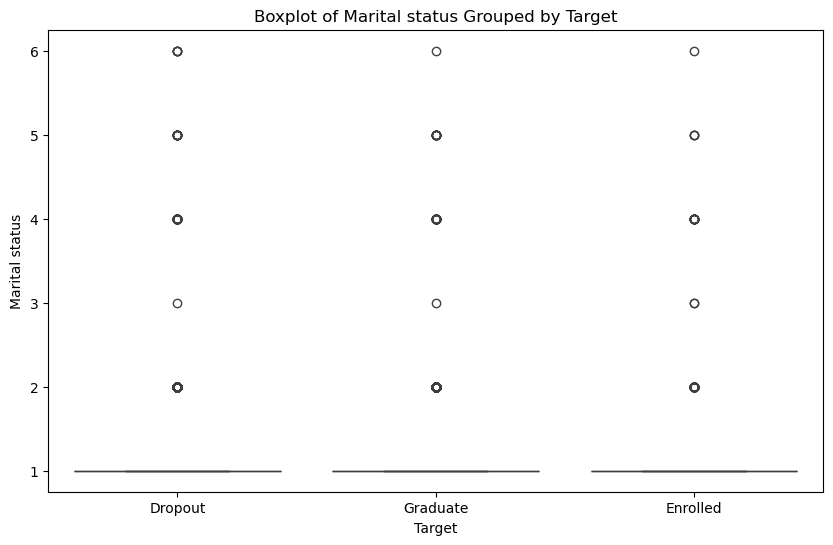

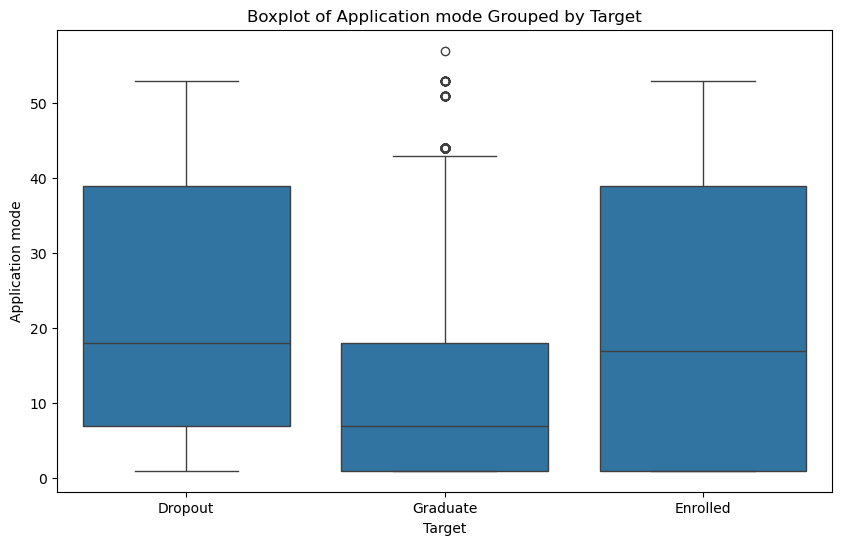

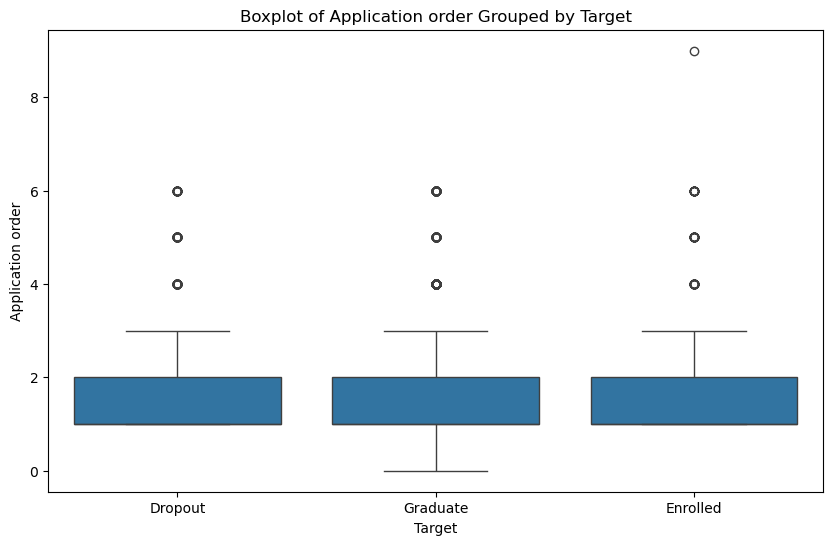

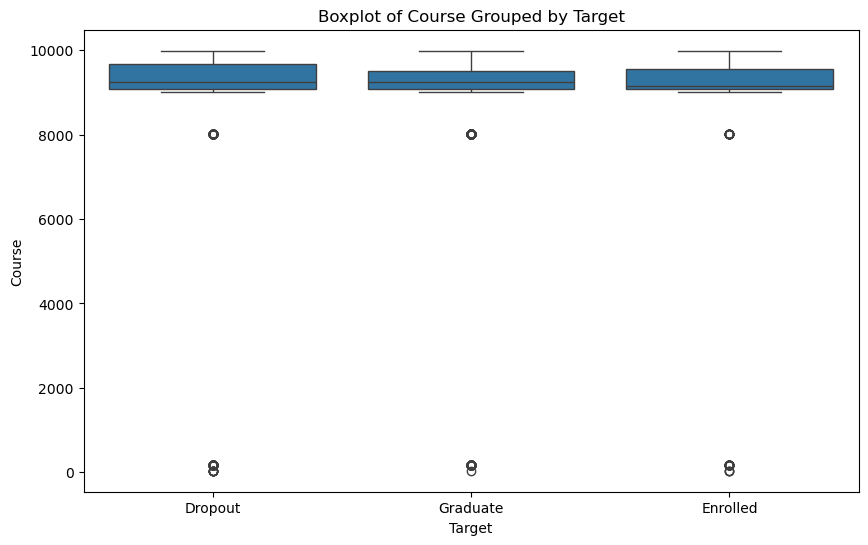

c:\Users\matiwos.desalegn\AppData\Local\miniconda3\envs\student-dropout-prediction\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


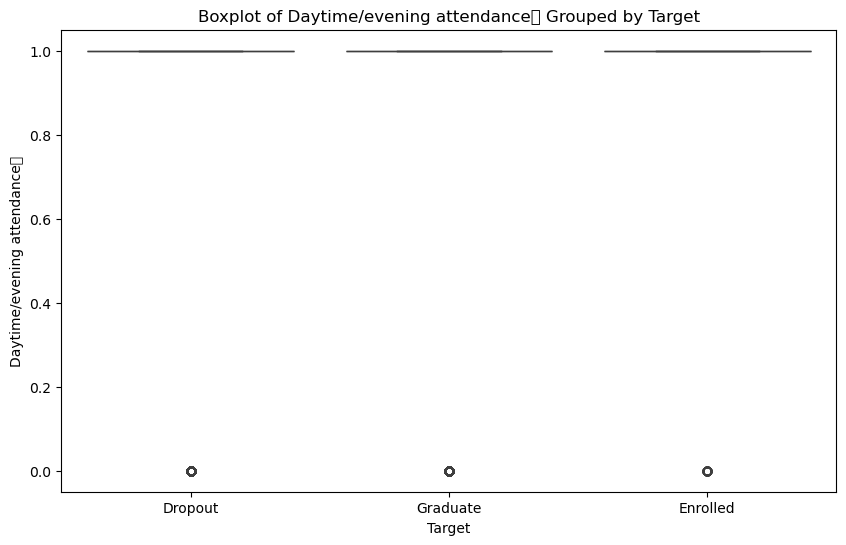

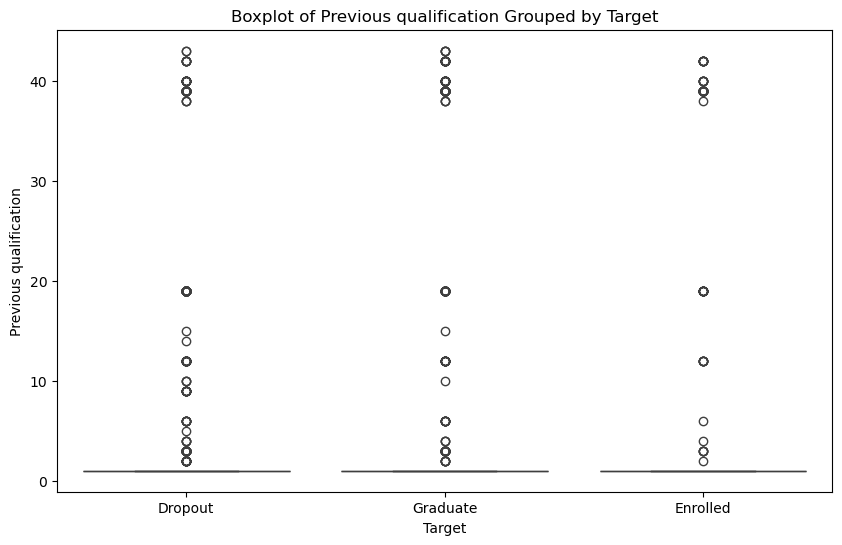

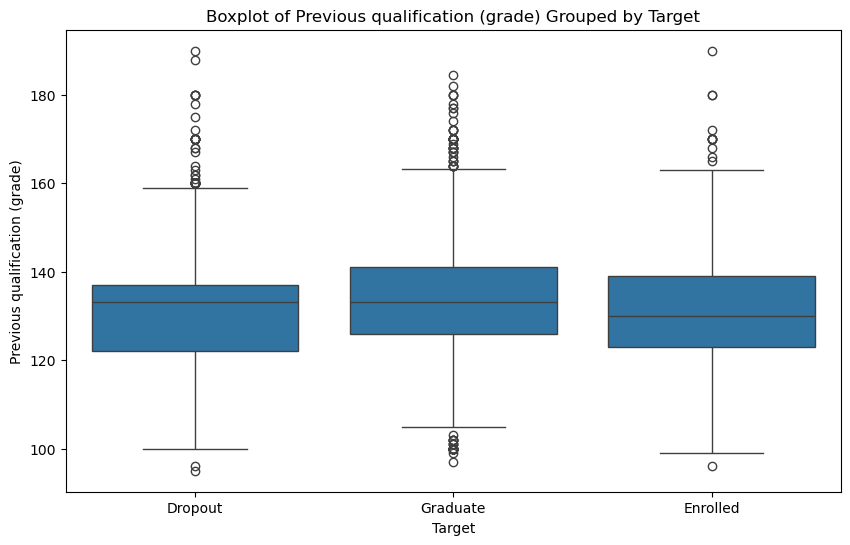

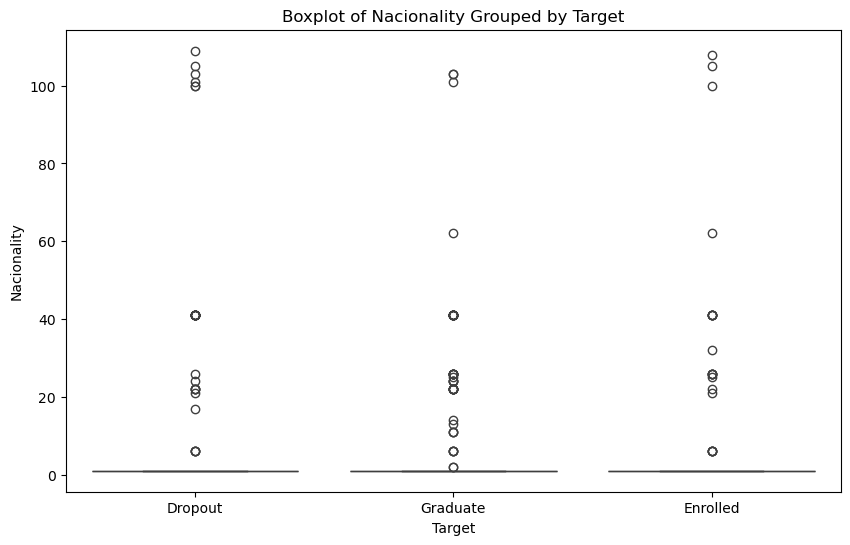

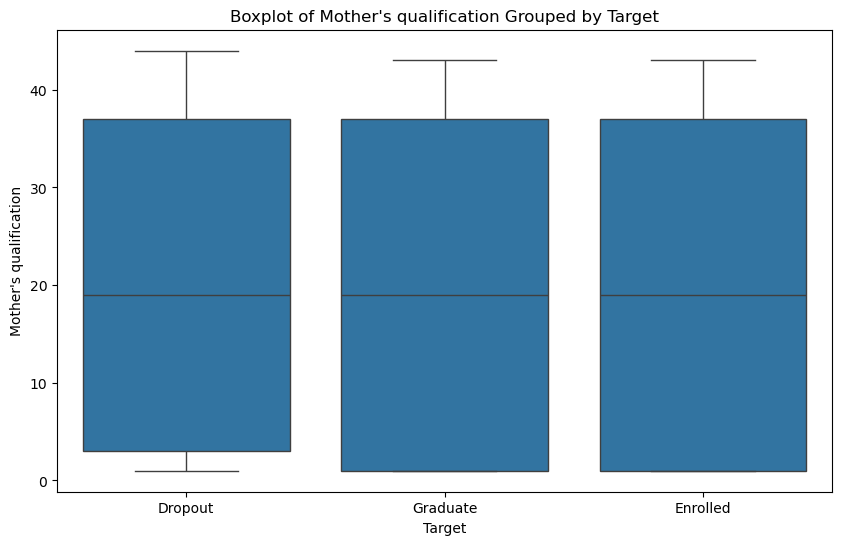

...

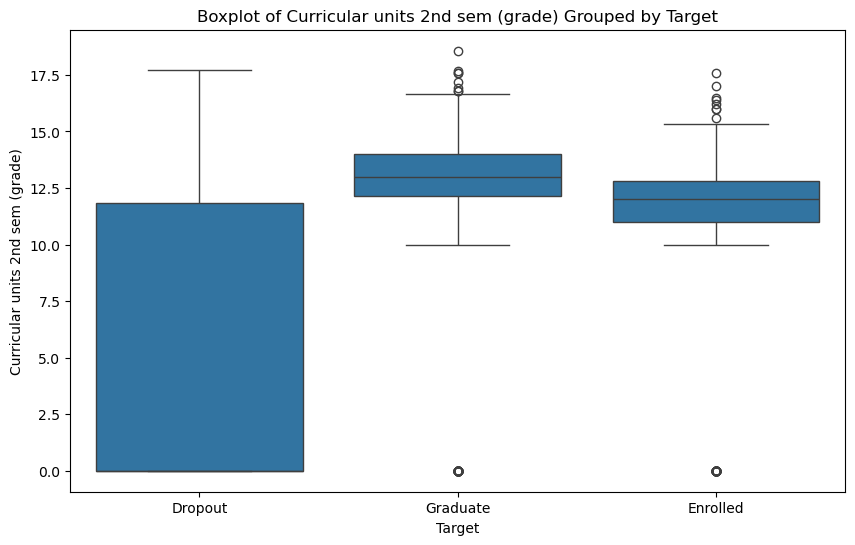

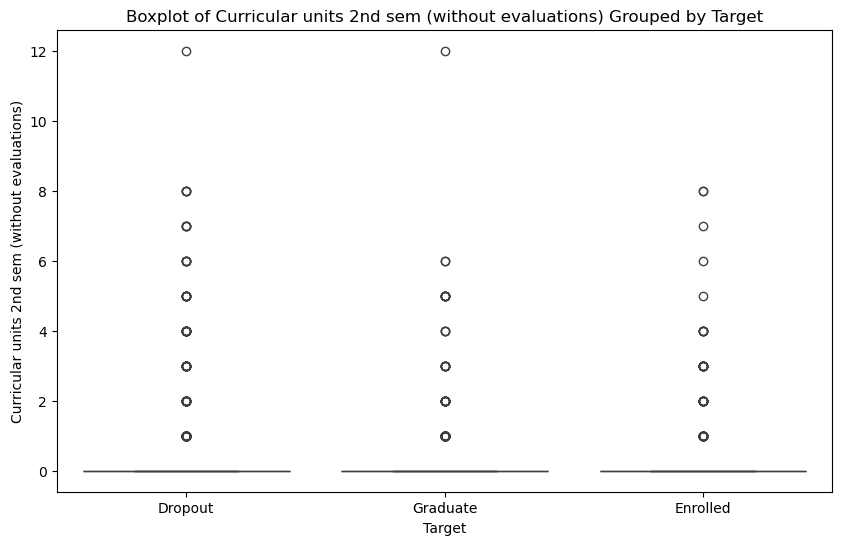

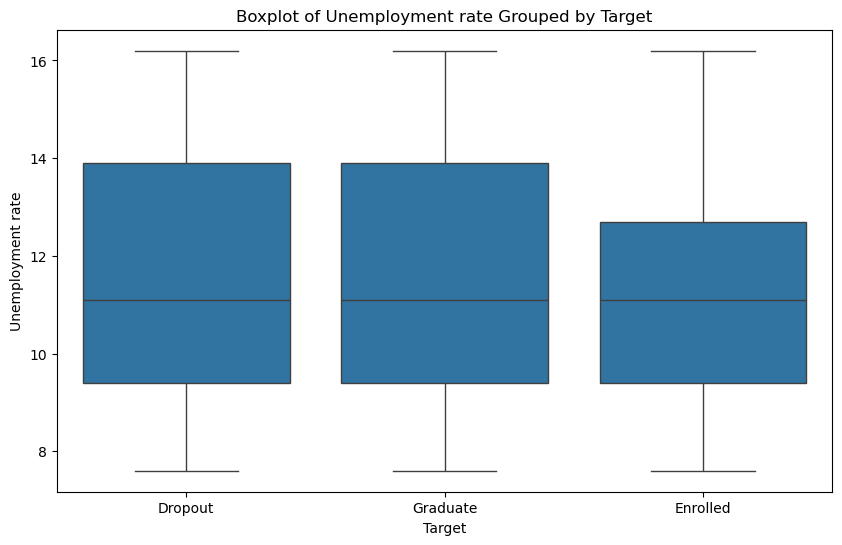

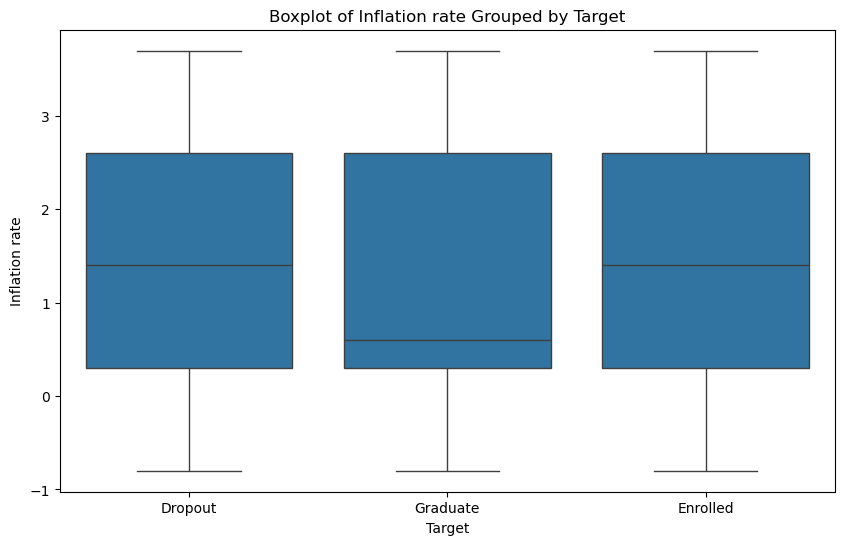

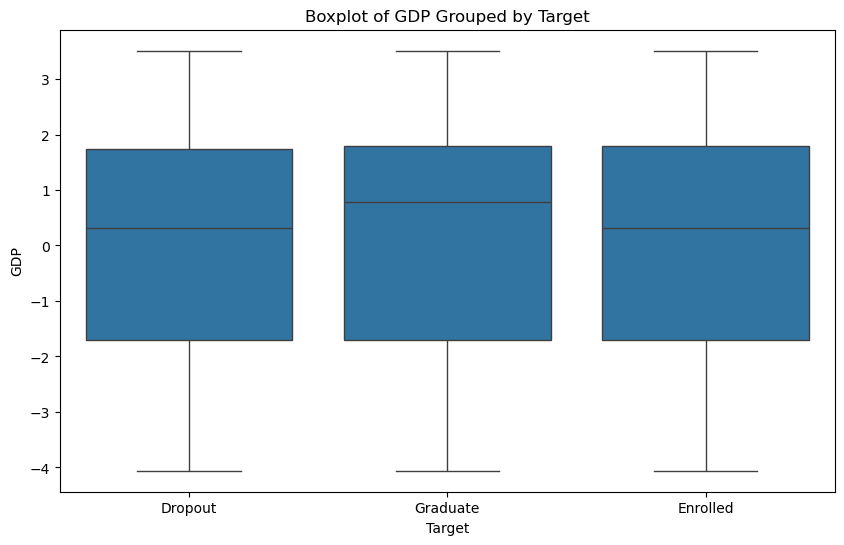

In [17]:
# Box plots of numerical variables grouped by categorical variables
for col in numerical_columns:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='Target', y=df[col], data=df)
    plt.title(f'Boxplot of {col} Grouped by Target')
    plt.show()

c:\Users\matiwos.desalegn\AppData\Local\miniconda3\envs\student-dropout-prediction\lib\site-packages\seaborn\utils.py:61: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  fig.canvas.draw()
c:\Users\matiwos.desalegn\AppData\Local\miniconda3\envs\student-dropout-prediction\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


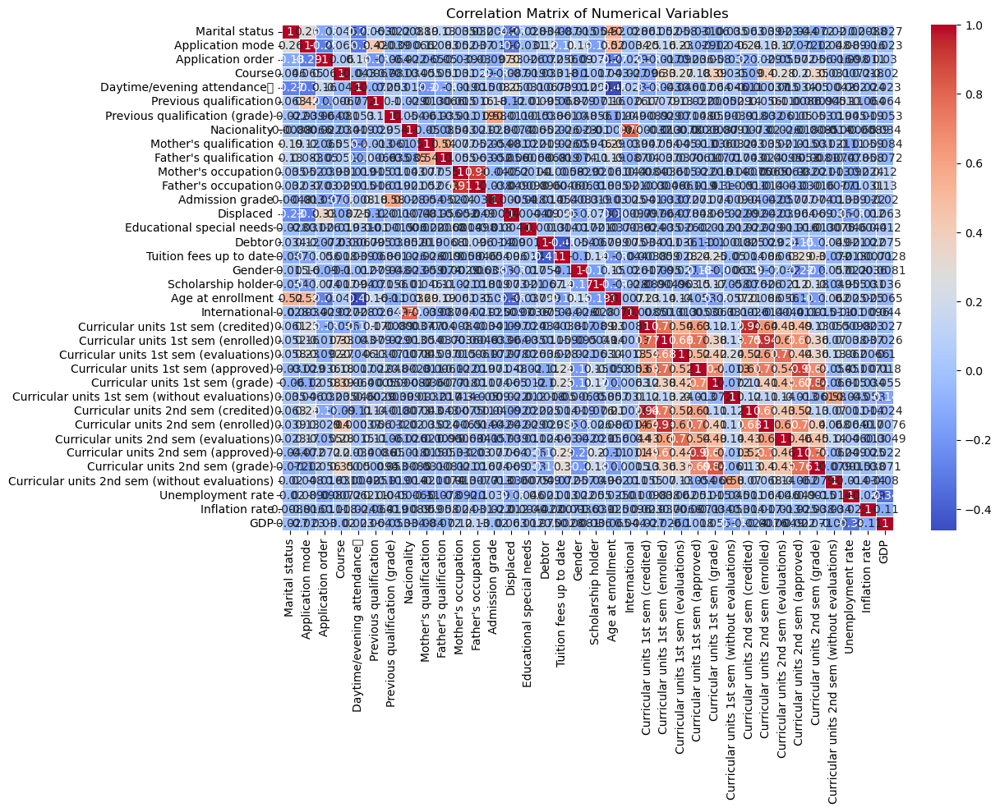

In [18]:
# Correlation matrix and heatmap
correlation_matrix = df[numerical_columns].corr()
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Matrix of Numerical Variables')
plt.show()

In [19]:
# Chi-square tests for categorical variables
from scipy.stats import chi2_contingency

for col in categorical_columns:
    contingency_table = pd.crosstab(df[col], df['Target'])
    chi2, p, dof, expected = chi2_contingency(contingency_table)
    print(f'Chi-square Test for {col} vs Target: p-value = {p}')

Chi-square Test for Target vs Target: p-value = 0.0


## 3. Multivariate Analysis

### Create pair plots, perform PCA, and generate parallel coordinate plots.

In [20]:
# Pair plots for numerical variables grouped by 'Target'
sns.pairplot(df, hue='Target', vars=numerical_columns)
plt.show()

c:\Users\matiwos.desalegn\AppData\Local\miniconda3\envs\student-dropout-prediction\lib\site-packages\seaborn\axisgrid.py:123: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\matiwos.desalegn\AppData\Local\miniconda3\envs\student-dropout-prediction\lib\site-packages\seaborn\utils.py:61: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  fig.canvas.draw()
c:\Users\matiwos.desalegn\AppData\Local\miniconda3\envs\student-dropout-prediction\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


In [21]:
# PCA (Principal Component Analysis)
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Standardizing the numerical data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(df[numerical_columns])

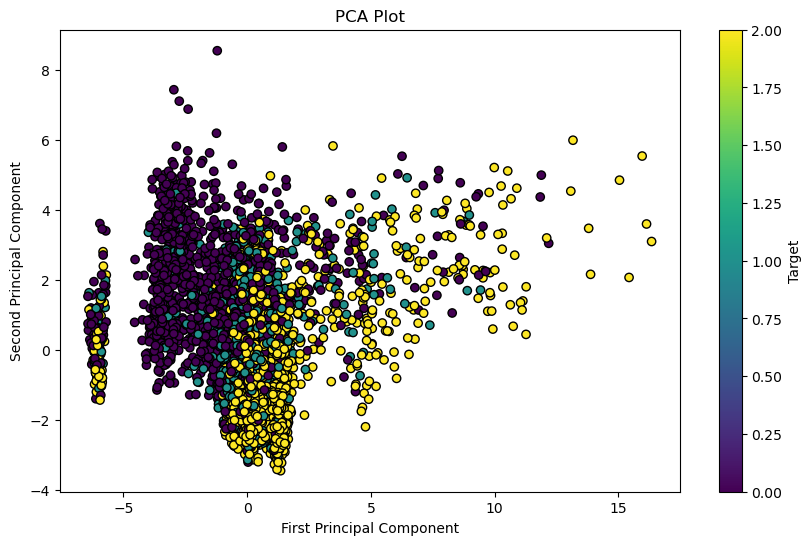

In [22]:
# Perform PCA
pca = PCA(n_components=2)
pca_data = pca.fit_transform(scaled_data)

# Create a PCA plot
plt.figure(figsize=(10, 6))
plt.scatter(pca_data[:, 0], pca_data[:, 1], c=pd.Categorical(df['Target']).codes, cmap='viridis', edgecolor='k')
plt.title('PCA Plot')
plt.xlabel('First Principal Component')
plt.ylabel('Second Principal Component')
plt.colorbar(label='Target')
plt.show()

c:\Users\matiwos.desalegn\AppData\Local\miniconda3\envs\student-dropout-prediction\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


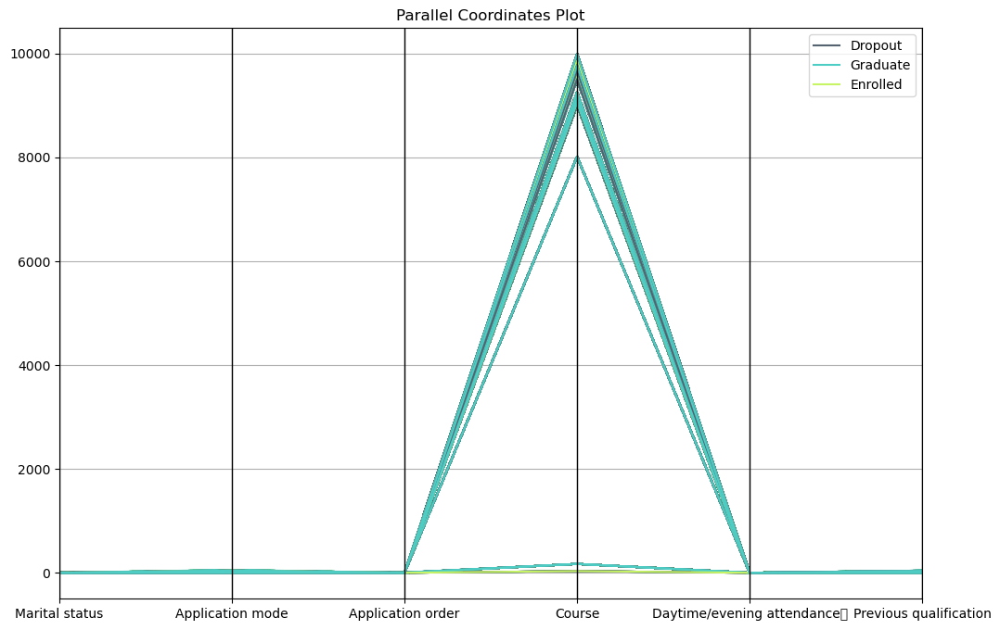

In [23]:
# Parallel Coordinates Plot
from pandas.plotting import parallel_coordinates

plt.figure(figsize=(12, 8))
parallel_coordinates(df, 'Target', cols=numerical_columns[:6], color=['#556270', '#4ECDC4', '#C7F464'])
plt.title('Parallel Coordinates Plot')
plt.show()

### create interactive visualizations using Plotly and potentially develop a dashboard with Streamlit.

#### 1. Age at enrollment seems to have a strong correlation with student performance.
#### 2. Higher admission grades tend to be associated with students who graduate.
#### 3. Financial factors like unemployment rate and inflation rate appear to be correlated with student dropout rates.
